<a href="https://colab.research.google.com/github/FGalvao77/Deep-Convolutional-Generative-Adversarial-Network-DCGAN-/blob/main/Deep_Convolutional_Generative_Adversarial_Network_(DCGAN).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Deep Convolutional Generative Adversarial Network (DCGAN)**

---



**Traduzido e _"adaptado"_ do artigo:**
- https://www.analyticsvidhya.com/blog/2021/07/deep-convolutional-generative-adversarial-network-dcgan-for-beginners/

As `GANs` são usadas para ensinar um modelo de aprendizado profundo (deep learning) para gerar novos dados a partir dessa mesma distribuição de dados de treinamento. Inventado por _Ian Goodfellow_ em 2014 no artigo [Generative Adversarial Nets](https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf). São compostos por dois modelos diferentes, um **gerador** e um **discriminador**. 
 - O gerador produz imagens sintéticas ou falsas que se parecem com imagens de treinamento. 
 - O discriminador analisa uma imagem e a saída e verifica se a imagem é real ou falsa. 
 
Durante o treinamento, o gerador gera imagens falsas melhores e engana o discriminador para acreditar que a imagem gerada é uma imagem real e o discriminador tenta se tornar melhor na detecção e classificação se a imagem é real ou falsa.

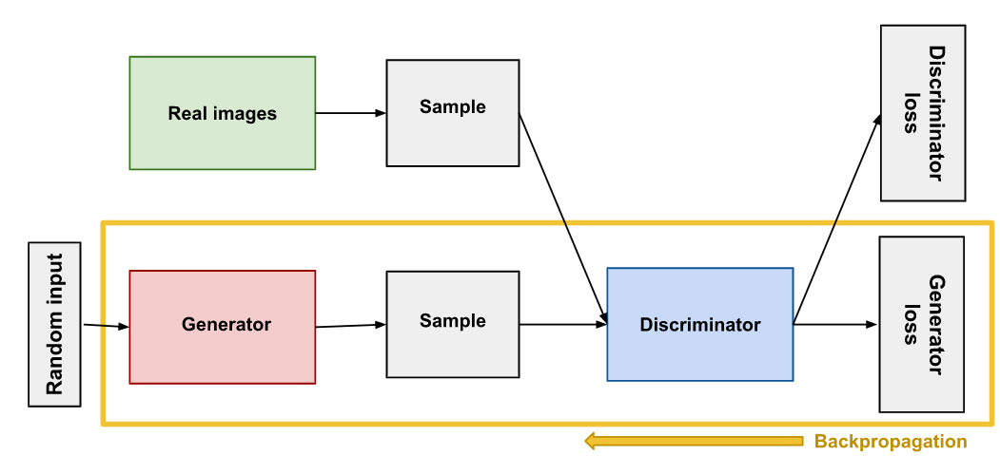

- Fonte: [https://developers.google.com/machine-learning/gan/generator](https://developers.google.com/machine-learning/gan/generator)

**DCGAN**

`DCGAN` usa camadas de transposição convolucional e convolucional no gerador e no discriminador, respectivamente. Foi proposto por _Radford et. al._ no artigo [Unsupervisioned Representation Learning With Deep Convolutional Generative Adversarial Networks](https://arxiv.org/pdf/1511.06434.pdf). Aqui o discriminador consiste em camadas de convolução strided, camadas de normalização em lote e LeakyRelu como função de ativação. É preciso uma imagem de entrada 3x64x64. O gerador consiste em camadas de transposição convolucional, camadas de normalização de lote e ativações de ReLU. A saída será uma imagem RGB 3x64x64.

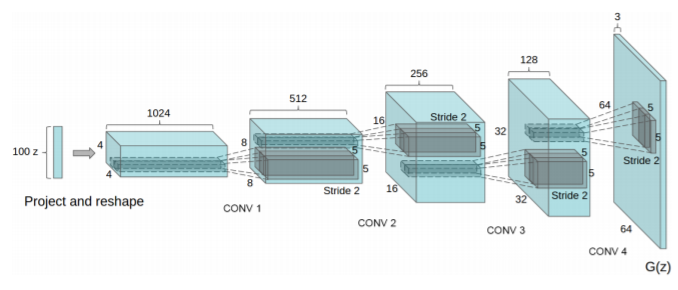

- Fonte: Paper [“Unsupervised Representation Learning With Deep Convolutional Generative Adversarial Networks”](https://arxiv.org/pdf/1511.06434.pdf)

Vamos implementar o **DCGAN** usando o conjunto de dados de imagens de cães e gatos, que está disponível no [Kaggle](https://www.kaggle.com/c/dogs-vs-cats). 

Baixei os dados e, "subi-os" para o meu _google drive_, onde estaremos utilizando o ambiente do `Colab` para acessar as imagens e realizar caso de estudo.

In [1]:
# função para acessar o google drive
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [2]:
# com a função "unzip" iremos descompactar o arquivo e, salvar todo seu conteúdo na pasta "dataset_imgs_dogs_cats"
!unzip /content/drive/MyDrive/imagens_Dogs_Cats.zip -d '/content/dataset_imgs_dogs_cats'

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5499.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.55.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.550.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5500.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5501.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5502.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5503.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5504.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5505.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5506.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5507.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5508.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.5509.jpg  
  inflating: /content/dataset_imgs_dogs_cats/train/dog.551.jpg  
  inflating: /content

In [3]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

Definindo as entradas:

- `dataroot`; caminho para a raiz da pasta do conjunto de dados;
- `workers`: número de threads de trabalho para carregar os dados com a ajuda do _DataLoader_;
- `batch_size`: tamanho do lote usado no treinamento;
- `image_size`: tamanho espacial das imagens usadas para treinamento;
- `nc`: número de canais de cores nas imagens de entrada;
- `nz`: comprimento do vetor latente;
- `ngf`: refere-se à profundidade dos mapas de recursos;
- `ndf`: define a profundidade dos mapas de recursos propagados através do discriminador;
- `num_epochs`: número de épocas de treinamento a serem executadas;
- `lr`: taxa de aprendizado para treinamento;
- `beta1`: hiperparâmetro beta1 para otimizadores Adam e,
- `ngpu`: número de GPUs disponíveis [0 para processador].

In [4]:
dataroot = '/content/dataset_imgs_dogs_cats'
workers = 2
batch_size = 128
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 50
lr = 0.0002
beta1 = 0.5
ngpu = 1

Usando a função/classe `dset.ImageFolder`, que requer um subdiretório na pasta raiz do conjunto de dados. Podemos criar o dataloader e, visualizar alguns dos dados de treinamento.

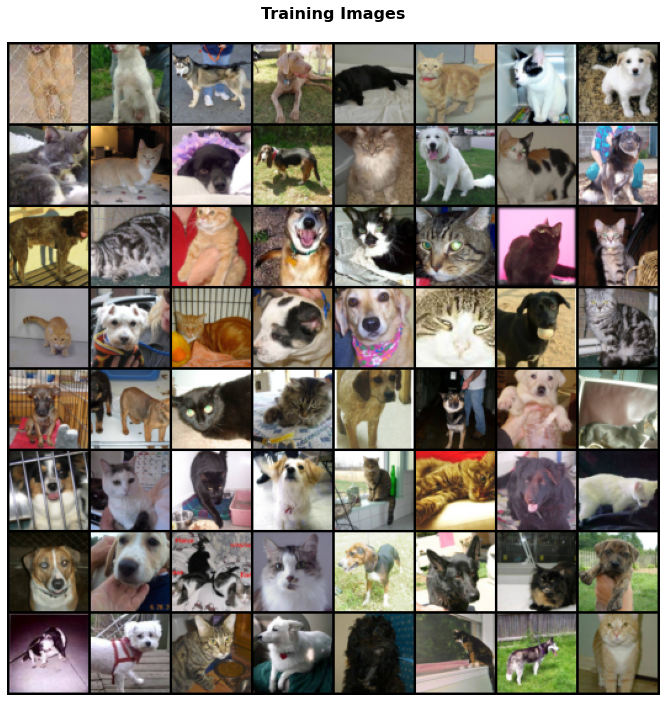

In [5]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device('cuda:0' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')

# Plot some training images
real_batch = next(iter(dataloader))

plt.figure(figsize=(12,12))
plt.axis('off')
plt.title('Training Images\n', {'fontsize': 16,'fontweight': 'bold'})
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)));

**Inicialização de peso**

A partir do documento _DCGAN_, todos os pesos do modelo são inicializados aleatoriamente a partir de uma distribuição Normal com `média=0, desvio_padrão=0,02`. 

O modelo inicializado será fornecido como entrada para a função **weights_init** e reinicializará todas as camadas para atender aos critérios de inicialização de peso.

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

**Instanciando o gerador**

In [7]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [8]:
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


**Instanciando o discriminador**

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


**Não, inicializamos a função de perda e o otimizador**

Vamos usar a função de perda `.BCELoss()` e o otimizador `.Adam()` tantao para o gerador e o discriminador.

In [11]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

**Iniciando o treinamento do modelo DCGAN**

In [12]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print('Starting Training Loop...')
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/50][0/196]	Loss_D: 2.1118	Loss_G: 7.0429	D(x): 0.7696	D(G(z)): 0.7767 / 0.0017
[0/50][50/196]	Loss_D: 0.2996	Loss_G: 8.6714	D(x): 0.9663	D(G(z)): 0.2202 / 0.0002
[0/50][100/196]	Loss_D: 0.3843	Loss_G: 3.9209	D(x): 0.8679	D(G(z)): 0.1843 / 0.0279
[0/50][150/196]	Loss_D: 0.4251	Loss_G: 4.7613	D(x): 0.8115	D(G(z)): 0.1398 / 0.0145
[1/50][0/196]	Loss_D: 0.3839	Loss_G: 5.5379	D(x): 0.8113	D(G(z)): 0.0268 / 0.0065
[1/50][50/196]	Loss_D: 0.1767	Loss_G: 6.5163	D(x): 0.9181	D(G(z)): 0.0355 / 0.0023
[1/50][100/196]	Loss_D: 1.0534	Loss_G: 5.1948	D(x): 0.4858	D(G(z)): 0.0058 / 0.0110
[1/50][150/196]	Loss_D: 0.3162	Loss_G: 4.4321	D(x): 0.8613	D(G(z)): 0.1263 / 0.0168
[2/50][0/196]	Loss_D: 0.9406	Loss_G: 6.0374	D(x): 0.8394	D(G(z)): 0.4341 / 0.0041
[2/50][50/196]	Loss_D: 0.4783	Loss_G: 4.3597	D(x): 0.8574	D(G(z)): 0.2440 / 0.0160
[2/50][100/196]	Loss_D: 0.4422	Loss_G: 3.5819	D(x): 0.7702	D(G(z)): 0.0964 / 0.0438
[2/50][150/196]	Loss_D: 0.3194	Loss_G: 4.6046	D(x): 0.9101	

**Plotando as perdas do gerador e do discriminador**

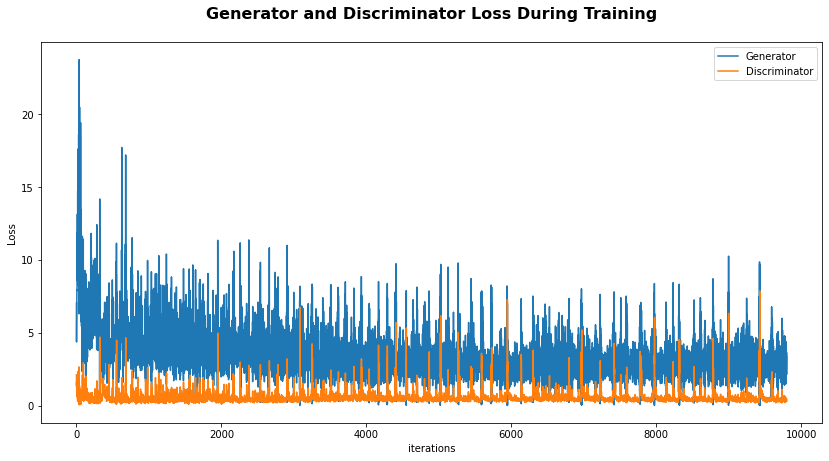

In [13]:
plt.figure(figsize=(14,7))
plt.title('Generator and Discriminator Loss During Training\n', 
          {'fontsize': 16,'fontweight': 'bold'})

plt.plot(G_losses,label='Generator')
plt.plot(D_losses,label='Discriminator')

plt.xlabel('iterations')
plt.ylabel('Loss')

plt.legend()
plt.show()

Animation size has reached 22084631 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


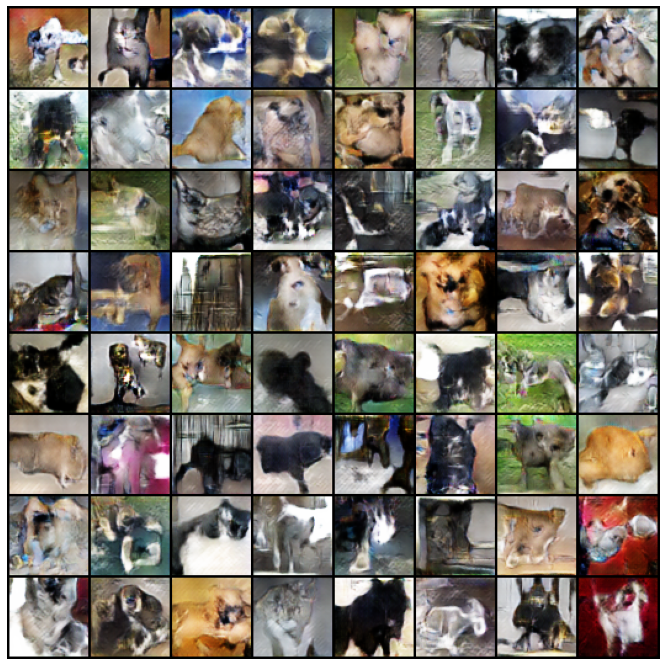

In [14]:
fig = plt.figure(figsize=(12,12))

plt.axis('off')
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Por fim, vamos comparar imagens reais e imagens falsas lado a lado**

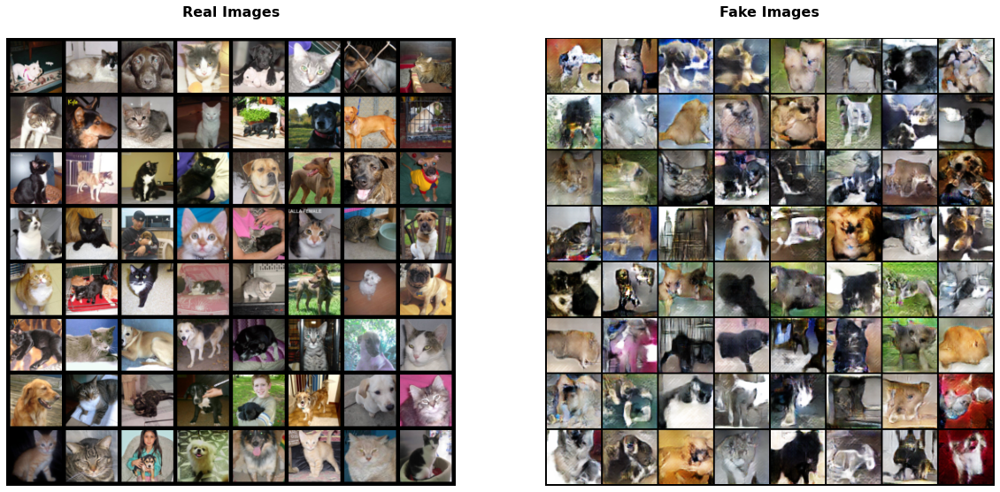

In [17]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(20,15))

plt.subplot(1,2,1)
plt.axis('off')
plt.title('Real Images\n', 
          {'fontsize': 16,'fontweight': 'bold'})
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))


# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis('off')
plt.title('Fake Images\n', 
          {'fontsize': 16,'fontweight': 'bold'})
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()